# 532 Lec 6 - Linking plots, maps in plotly and deployment on Heroku

You need to download this notebook to view images.

## Lecture learning goals

By the end of the lecture you will be able to:

1. Implement server side interactivity between plots
2. Work with geojson files in plotly
3. Create maps with interactivity
4. Setup and Heroku account and run the Heroku CLI
5. Prepare the necessary files for deployment
6. Push to Heroku's repo and troubleshoot remote errors

## Table of Contents

You can view the ToC by opening this in your local Jupyter Lab,
and downloading the ToC extension
by going to the Extension Manager tab in the left sidebar, searching for "toc", and clicking "install"
(I posted [a video about this on slack](https://ubc-mds.slack.com/archives/C24GEJS11/p1599940203406600) if you can't find the extension).

# Linking interactive plots

## What is the return value from the selected data in a scatter plot?

Let's start from where we left off last lecture.

```text
library(dash)
library(dashCoreComponents)
library(dashHtmlComponents)
library(dashBootstrapComponents)
library(ggplot2)
library(plotly)

app <- Dash$new(external_stylesheets = dbcThemes$BOOTSTRAP)

app$layout(
    dbcContainer(
        list(
            dccGraph(id='plot-area'),
            htmlDiv(id='output-area'),
            htmlBr(),
            dccDropdown(
                id='col-select',
                options = msleep %>% colnames %>% purrr::map(function(col) list(label = col, value = col)),
                value='bodywt')
        )
    )
)

app$callback(
    output('plot-area', 'figure'),
    list(input('col-select', 'value')),
    function(xcol) {
        p <- ggplot(msleep) +
            aes(x = !!sym(xcol),
                y = sleep_total,
                color = vore,
                text = name) +
            geom_point() +
            scale_x_log10() +
            ggthemes::scale_color_tableau()
        ggplotly(p, tooltip = 'text') %>% layout(dragmode = 'select')
    }
)

app$callback(
    output('output-area', 'children'),
    list(input('plot-area', 'selectedData')),
         function(selected_data) {
             list(toString(selected_data))
         }
    )

app$run_server(debug = T)

```

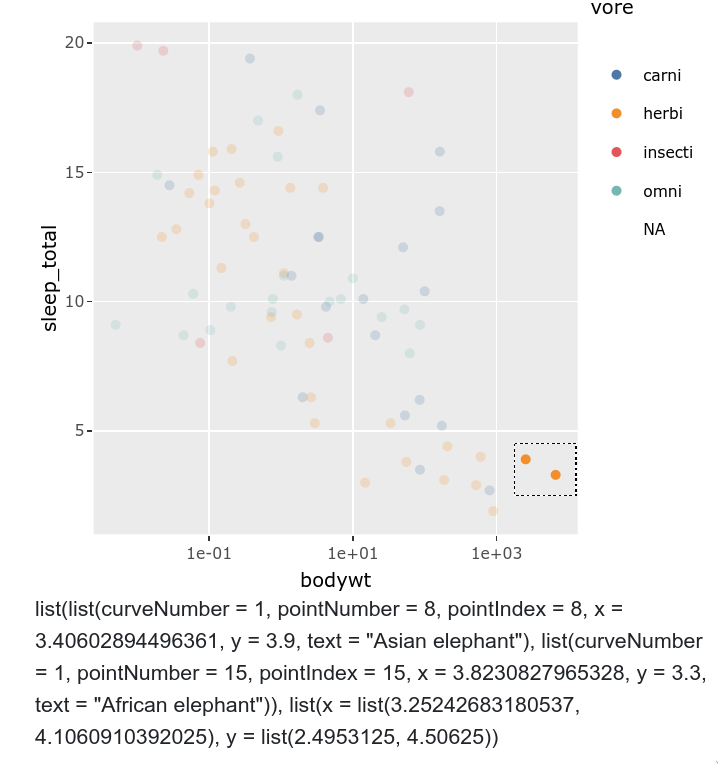

The output from our selected data look like this when displayed as a string in the HTML div.
Another way to see these lists of names lists is to print them to the console inside your function with `print()`, and then they will look slightly different.

```
list(list(curveNumber = 1, pointNumber = 8, pointIndex = 8, x = 3.40602894496361, y = 3.9, text = "Asian elephant"), list(curveNumber = 1, pointNumber = 15, pointIndex = 15, x = 3.8230827965328, y = 3.3, text = "African elephant")), list(x = list(3.25242683180537, 4.1060910392025), y = list(2.4953125, 4.50625))
```

This is a list consisting of two named lists.
The first one (`selected_data[[2]]`) is pretty uninteresting for us
as it contains the x and y values of the rectangular selection
we created when dragging with the mouse:

```
list(x = list(3.25242683180537, 4.1060910392025), y = list(2.4953125, 4.50625))
```

The first one (`selected_data[[1]]`) has all the info of our selected points:

```
list(curveNumber = 1, pointNumber = 8, pointIndex = 8, x = 3.40602894496361, y = 3.9, text = "Asian elephant"),
list(curveNumber = 1, pointNumber = 15, pointIndex = 15, x = 3.8230827965328, y = 3.3, text = "African elephant")
```

One named list for the first point (Asian elephant) and one for the second point (African elephant).
- `curveNumber` indicates which group/color the point belongs to.
- `pointNumber` and `pointIndex` unfortunately does not represent the row numbers in the data frame, but rather some ordering internal to plotly.
- The `x` and `y` values represent the position of the point in our graph based on the x and y columns we chose.
- The `text` value holds everything contained in our tooltip 
  and if we include more than one value,
  the values will be separated by `<br>` in the returned string.
  
The most interesting values for us here are `x`, `y`, and `text`
since these can include features that are useful for filtering data in another callback.
If the feature you want to use for filtering is not on `x` or `y`,
include it in the tooltip, ideally as a single value.
Plotly does support a [`customdata` attribute](https://plotly-r.com/supplying-custom-data.html)
which can be used to bass along arbitrary features
that you might want to filter on,
but for some reason this does not seem to work with `ggplotly`.
If you happen to be already using `plotly` directly for some part of your dashboard,
feel free to use `customdata`,
but for `ggplotly` use the strategy outlined above.

## How to filter a dataframe based on the selected value

Now that we know which part of the selection we want,
how do we use it to filter our data?
First we need to extract just the part that we want from the named list.
For a single named list,
we could simply access that element with a name,
but since we might select multiple points
we need to map the name access to each point in the list.
In Python this would be a list comprehension,
and in R we can use `purrr` to map a selection to every item in the list
(similar to what we saw in setting the options for the dropdown)

In this example,
we want to grab the `text` field from the returned selected_data value:

```r
selected_data[[1]] %>% purrr::map_chr('text')
## Asian elephant, African elephant
```

The return value is a vector of the type we specified in purrr.
If we wanted to grab an integer or float/double instead of a text string,
we would use `map_int` or `map_dbl` instead.

Now that we have these values,
we can use them to filter our data frame with like so:

```r
animal_names <- selected_data[[1]] %>% purrr::map_chr('text')
msleep %>% filter(name %in% animal_names)
```

If you don't have a unique feature (like `name` here) to use for filtering,
you can create a "metadata/ID" column consisting of your dataframes rownames
and then assign this to the text and tooltip property,
so that you can use it to reference back to your dataframe.

With these changes, 
the calback would look like this:

```r
app$callback(
    output('output-area', 'children'),
    list(input('plot-area', 'selectedData')),
    function(selected_data) {
        animal_names <- selected_data[[1]] %>% purrr::map_chr('text')
        print(msleep %>% filter(name %in% animal_names))
        toString(animal_names)  # Only for printing the names in the div
    }
)
```

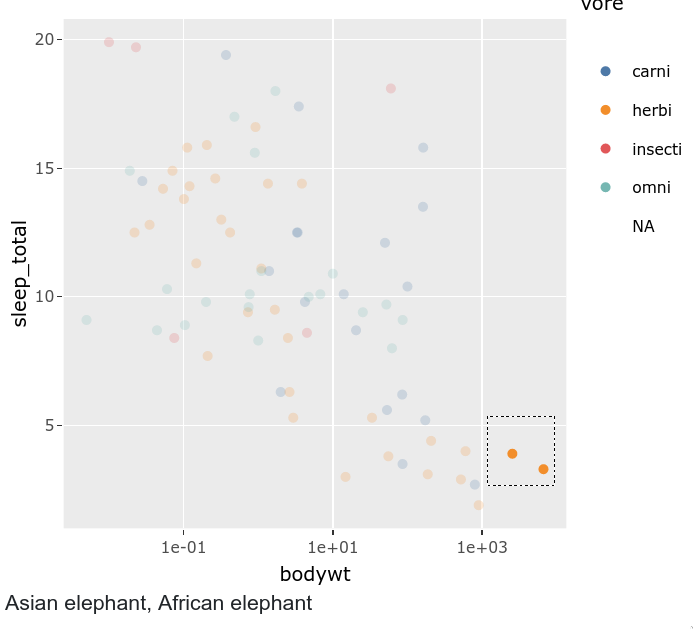

You can see in the printed console output that we have filtered correctly

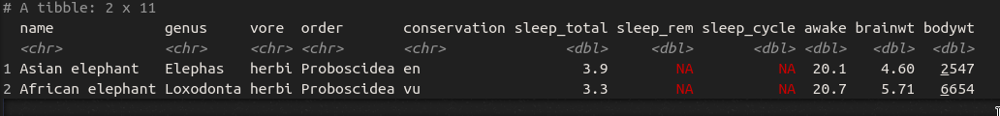

## Plotting the selected data via another callback (a.k.a. server side interactivity)

To use these selected values to create a plot,
we would set up a regular callback,
"purrr out" the values we want,
filter our dataframe and use thie data for plotting.
We will also change the div output area for another plotting area,
so that our app now looks like this:

```text
library(dash)
library(dashCoreComponents)
library(dashHtmlComponents)
library(dashBootstrapComponents)
library(ggplot2)
library(plotly)

app <- Dash$new(external_stylesheets = dbcThemes$BOOTSTRAP)

app$layout(
    dbcContainer(
        list(
            dccGraph(id='plot-area'),
            dccGraph(id='bar-plot'),
            htmlBr(),
            dccDropdown(
                id='col-select',
                options = msleep %>% colnames %>% purrr::map(function(col) list(label = col, value = col)),
                value='bodywt')
        )
    )
)

app$callback(
    output('plot-area', 'figure'),
    list(input('col-select', 'value')),
    function(xcol) {
        p <- ggplot(msleep) +
            aes(x = !!sym(xcol),
                y = sleep_total,
                color = vore,
                text = name) +
            geom_point() +
            scale_x_log10() +
            ggthemes::scale_color_tableau()
        ggplotly(p, tooltip = 'text') %>% layout(dragmode = 'select')
    }
)

app$callback(
    output('bar-plot', 'figure'),
    list(input('plot-area', 'selectedData')),
    function(selected_data) {
        animal_names <- selected_data[[1]] %>% purrr::map_chr('text')
        p <- ggplot(msleep %>% filter(name %in% animal_names)) +
            aes(y = vore,
                fill = vore) +
            geom_bar(width = 0.6) +
            ggthemes::scale_fill_tableau()
        ggplotly(p, tooltip = 'text') %>% layout(dragmode = 'select')
    }
)
app$run_server(debug = T)
```

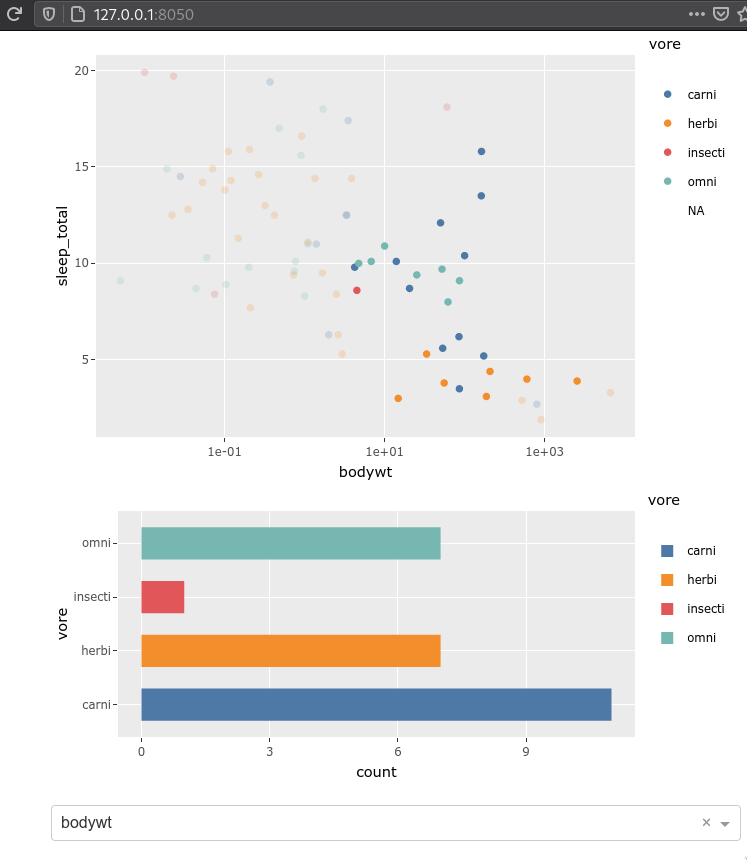

More on ggplotly can be found in the docs and also [in this separate resource,
which goes some additional plotly functions we can use to control the ggplot objects)[https://plotly-r.com/improving-ggplotly.html].

# Creating maps with plotly

There are a few different approaches to maps we could could we dashr,
including `geom_df` and `leaflet`,
and here we will use plotly's map plotting functions.

We can [use our own geojson files with plotly](https://plotly.com/r/choropleth-maps/),
and just like for Altair,
they also supply data sets for the coutries of the world,
and the US states.
In fact,
the default in plotly's `choropleth` function is to show a map of the world.

In [4]:
df <- read.csv("https://raw.githubusercontent.com/plotly/datasets/master/2014_world_gdp_with_codes.csv")
head(df)

,COUNTRY,GDP..BILLIONS.,CODE
,<chr>,<dbl>,<chr>
1,Afghanistan,21.71,AFG
2,Albania,13.40,ALB
3,Algeria,227.80,DZA
4,American Samoa,0.75,ASM
5,Andorra,4.80,AND
6,Angola,131.40,AGO


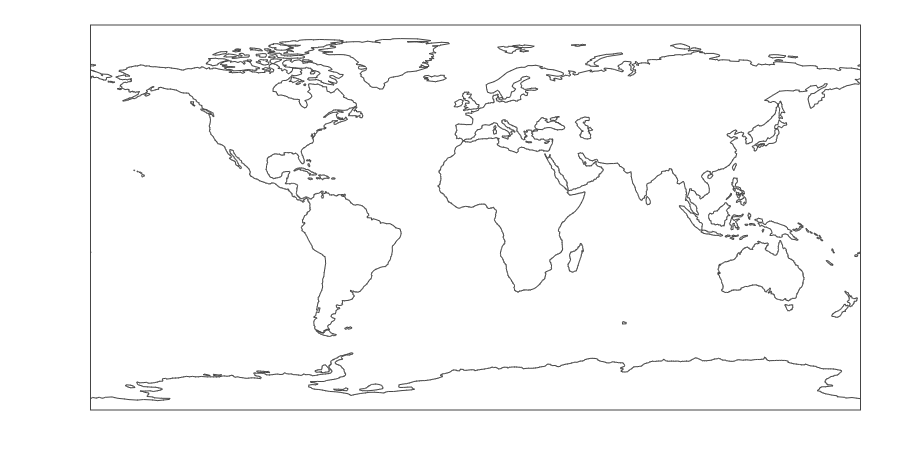

In [5]:
library(plotly)

plot_ly(df, type='choropleth')

These are zoomable by default and can be linked to datasets with country codes.

Plotly uses `~` to reference a variable/column name in the dataframe.

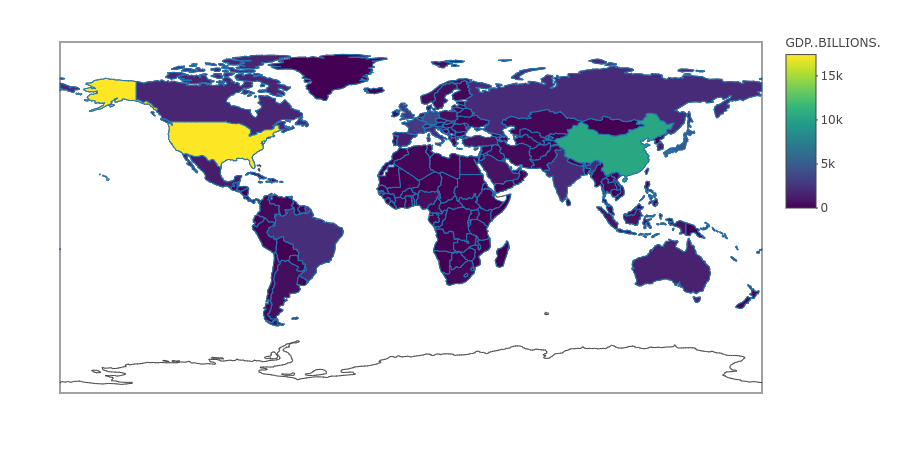

In [6]:
plot_ly(df, type='choropleth', locations=~CODE, z=~GDP..BILLIONS.)

The value and country code is shown by default in the tooltip, and we can add any info from the data frame that we want.
We can also change the colorscale,
either [manually as per the docs](https://plotly.com/r/reference/#heatmap-colorscale)
or to one of these built-in strings:

```
Greys,YlGnBu,Greens,YlOrRd,Bluered,RdBu,Reds,Blues,Picnic,
Rainbow,Portland,Jet,Hot,Blackbody,Earth,Electric,Viridis,Cividis
```

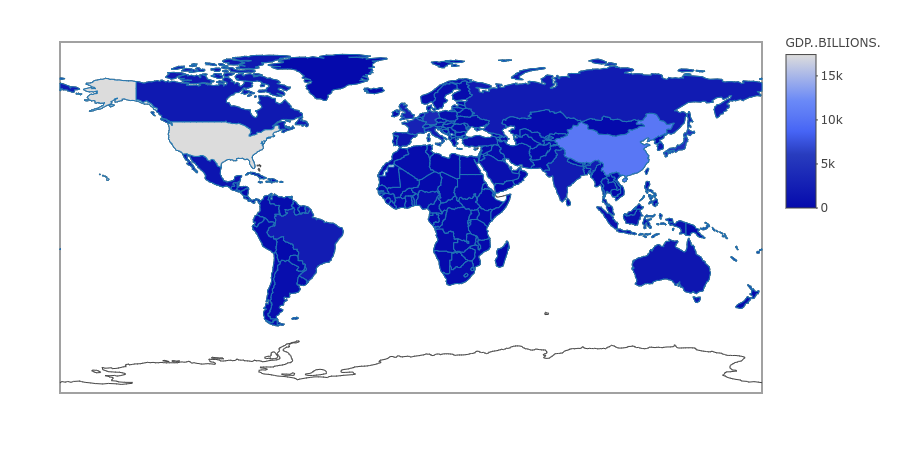

In [7]:
plot_ly(df, type='choropleth', locations=~CODE, z=~GDP..BILLIONS., text=~COUNTRY, colorscale='Blues')

Let's use some US export data to see how we can zoom in on an area of the map.

In [8]:
df <- read.csv("https://raw.githubusercontent.com/plotly/datasets/master/2011_us_ag_exports.csv")
head(df)

,code,state,category,total.exports,beef,pork,poultry,dairy,fruits.fresh,fruits.proc,total.fruits,veggies.fresh,veggies.proc,total.veggies,corn,wheat,cotton
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AL,Alabama,state,1390.63,34.4,10.6,481.0,4.06,8.0,17.1,25.11,5.5,8.9,14.33,34.9,70.0,317.61
2,AK,Alaska,state,13.31,0.2,0.1,0.0,0.19,0.0,0.0,0.00,0.6,1.0,1.56,0.0,0.0,0.00
3,AZ,Arizona,state,1463.17,71.3,17.9,0.0,105.48,19.3,41.0,60.27,147.5,239.4,386.91,7.3,48.7,423.95
4,AR,Arkansas,state,3586.02,53.2,29.4,562.9,3.53,2.2,4.7,6.88,4.4,7.1,11.45,69.5,114.5,665.44
5,CA,California,state,16472.88,228.7,11.1,225.4,929.95,2791.8,5944.6,8736.40,803.2,1303.5,2106.79,34.6,249.3,1064.95
6,CO,Colorado,state,1851.33,261.4,66.0,14.0,71.94,5.7,12.2,17.99,45.1,73.2,118.27,183.2,400.5,0.00


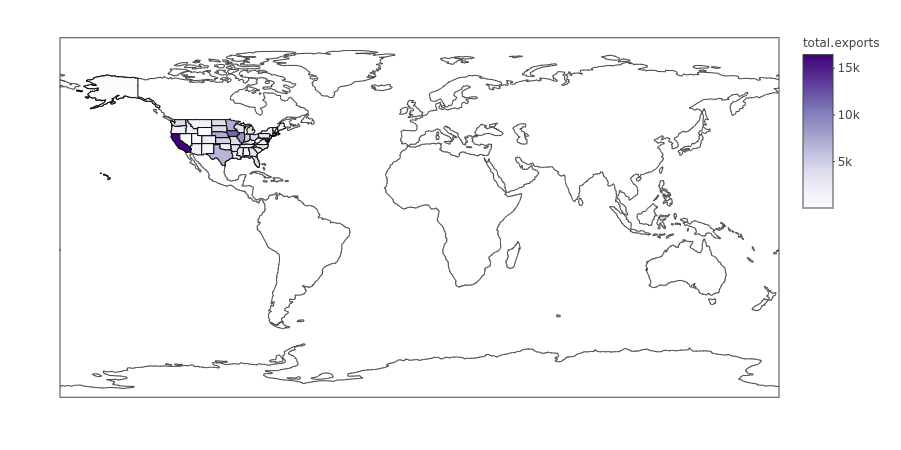

In [9]:
p <- plot_ly(df, type = 'choropleth', locationmode = 'USA-states',
    z = ~total.exports, locations = ~code, color = ~total.exports, colors = 'Purples')
p

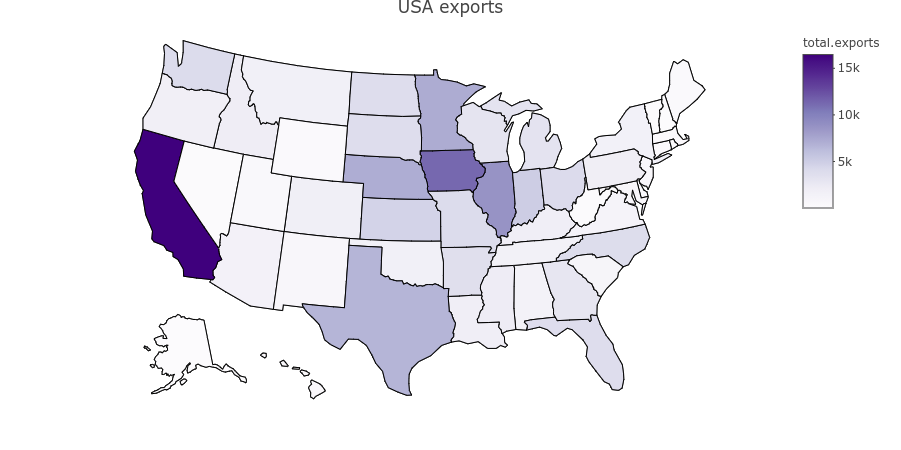

In [27]:
p %>% layout(geo = list(scope = 'usa', projection = list(type = 'albers usa')),
             title = 'USA exports')

You can select by dragging, or change to select via clicking. If you also want clicks to send a plotly click even to use in another callback, then use `'event+click'`. [More about click events in the docs](https://plotly.com/r/reference/layout/#layout-clickmode)

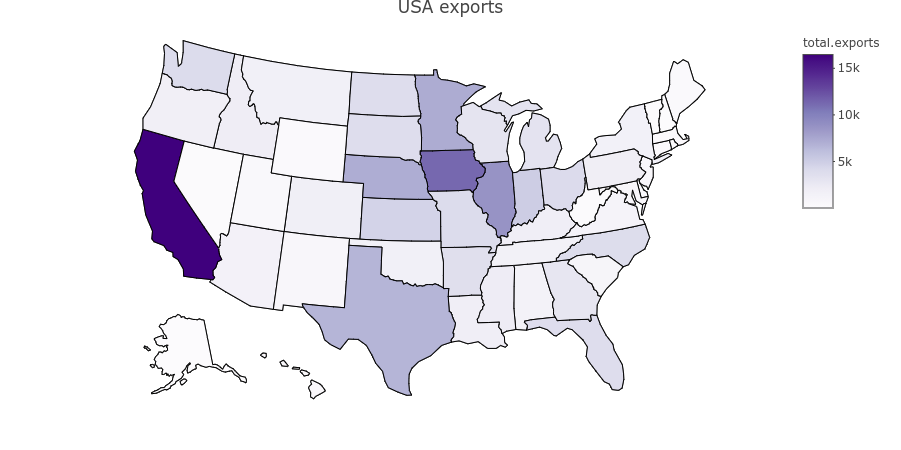

In [28]:
p %>% layout(geo = list(scope = 'usa', projection = list(type = 'albers usa')),
             title = 'USA exports', clickmode = 'event+select')

In [15]:
df <- read.csv('https://raw.githubusercontent.com/plotly/datasets/master/2014_us_cities.csv')
head(df)

,name,pop,lat,lon
,<chr>,<int>,<dbl>,<dbl>
1,New York,8287238,40.73060,-73.98658
2,Los Angeles,3826423,34.05372,-118.24273
3,Chicago,2705627,41.87555,-87.62442
4,Houston,2129784,29.75894,-95.36770
5,Philadelphia,1539313,39.95233,-75.16379
6,Phoenix,1465114,33.44677,-112.07567


Note that you need to use `plot_geo` when overlaying points with a longitude and latitude.
The syntax is very similar to `plot_ly`.

Warning message:
“`line.width` does not currently support multiple values.”
Warning message:
“`line.width` does not currently support multiple values.”


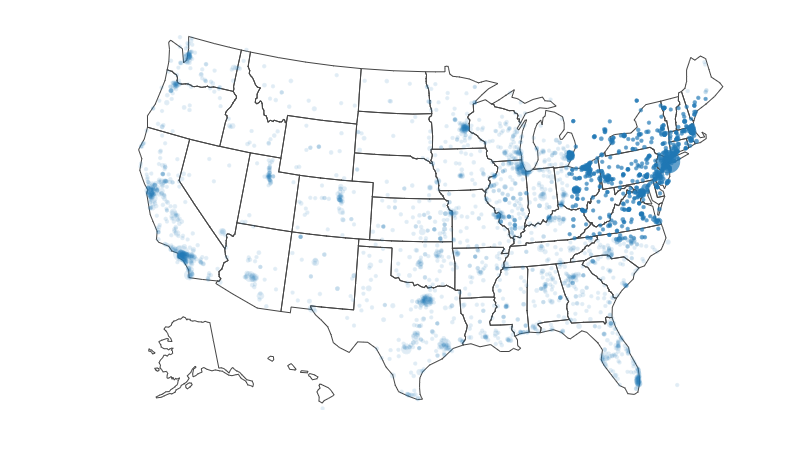

In [31]:
plot_geo(df, locationmode = 'USA-states', sizes = c(5, 250)) %>%
    layout(geo = list(scope = 'usa', projection = list(type = 'albers usa'))) %>%
    add_markers(x = ~lon, y = ~lat, size = ~pop, text = ~name, hoverinfo = 'text')

# Deployment on Heroku

For deployment we're going to follow the [dash documentation](https://dashr.plotly.com/deployment),
with a few important changes (detailed below).
The overall process is that we will create new files with the names and content mentioned in the dash docs to our existing project directory.
Therefore you don't need to do the first two steps telling your to create a new directory and run git init.
Your overall project structure should look similar to the below
and it can be a good idea to keep `app.R` in the root instead of in `src`,
unless you are comfortable making changes to the other files 
(it might just be changing the last line of the `Dockerfile`,
but I have not tested it.

```
├── data
│   └── your-data.csv
├── Dockerfile
├── app.R
├── apt-packages
├── dashr-deploy.Rproj
├── heroku.yml
└── init.R
```

## Changes to the dash docs instructions

1. Change the your last line to `app$run_server(host = '0.0.0.0.')` when deploying. This is needed for the app to bind correctly to the ports when deployed and removing `debug` also makes it easier to debug if something goes wrong since you will not see the error message otherwise (ironically enough).
2. Change the first line of the `Dockerfile` to pull container `3.6.3` instead of `3.6.2`. 
3. Use `here` together wit an `.Rproj` file in your project root to ensure that paths work when deployed.
4. Use `init.R` for installing R packages instead of the `Dockerfile`.
5. Change the last lines of `init.R` to the following, and feel free to add any additional packages you might need:

    ```
    # packages go here
    install.packages(c('dash', 'readr', 'here', 'ggthemes', 'remotes'))
    remotes::install_github('facultyai/dash-bootstrap-components@r-release')
    ```
    
The R deployment takes aroudn 15 min,
which makes it extra annoying if you mistype something or struggle with package installations.
Below are a few tips which could help save you time **if** you struggle with deployment.
If things are working fine,
you don't need the section below.

## Some heroku tips and tricks

Heroku has a command that allows us to ssh into the server after it is deployed (`heroku ps:exec`),
but it doesn't work on containers out of the box unfortunately
([steps for getting it to work here, I haven't tried](https://devcenter.heroku.com/articles/exec#using-with-docker)).
Instead we have two options:
we can send individual commands with `heroko run`,
e.g. `heroku run ls` etc.
However, these also take some time to run and connect each time.
Instead we could once send `heroku run bash`
which will put us in a bash shell on the server
and allow us to navigate the file system and check installed packages etc.
Of particular notice would be checking which R packages are installed,
via one of these commands:

```
Rscript -e "installed.packages()[,c('Package', 'Version')]"

# OR

Rscript -e "installed.packages()[,c('Package', 'Version')]" | grep readr
```

There is no command line text editor installed by default,
so if you want to make small changes to your files,
you would need to [follow the steps outlined here to install either vim or nano](https://stackoverflow.com/questions/12666799/what-text-editor-is-available-in-heroku-bash-shell).
However,
if modify `app.R` this way,
it will not update even if you have `debug = T` in `app$run_server`
(I believe this is because we are in a new shell rather than sshing into the one where our dashboard is actually running).
Also **note that all files are removed** when you push to heroku,
so don't make any extensive changes on the dyno itself.